<a href="https://colab.research.google.com/github/adawiaan/EndTermTask/blob/main/EndTermTask.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Adawia Ananda

NPM: 2106724883

In [ ]:
!pip install kaggle

In [ ]:
# configuring the path of Kaggle.json file
!mkdir -p ~/.kaggle
!cp kaggle (1).json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle (1).json

/bin/bash: -c: line 1: syntax error near unexpected token `('
/bin/bash: -c: line 1: `cp kaggle (1).json ~/.kaggle/'
/bin/bash: -c: line 1: syntax error near unexpected token `('
/bin/bash: -c: line 1: `chmod 600 ~/.kaggle/kaggle (1).json'


#Import Dataset Face Mask

In [ ]:
# API to fetch the dataset from Kaggle
!kaggle datasets download -d omkargurav/face-mask-dataset

Dataset URL: https://www.kaggle.com/datasets/omkargurav/face-mask-dataset
License(s): unknown
 99% 162M/163M [00:02<00:00, 55.6MB/s]
100% 163M/163M [00:02<00:00, 67.4MB/s]


In [ ]:
# extracting the compessed Dataset
from zipfile import ZipFile
dataset = '/content/face-mask-dataset.zip'

with ZipFile(dataset,'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [ ]:
!ls

 data   face-mask-dataset.zip  'kaggle (1).json'   sample_data


#Import Dependencies

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
from google.colab.patches import cv2_imshow
from PIL import Image
from sklearn.model_selection import train_test_split

In [ ]:
with_mask_files = os.listdir('/content/data/with_mask')
print(with_mask_files[0:5])

['with_mask_1099.jpg', 'with_mask_1513.jpg', 'with_mask_3700.jpg', 'with_mask_2380.jpg', 'with_mask_1825.jpg']


In [ ]:
without_mask_files = os.listdir('/content/data/without_mask')
print(without_mask_files[0:5])

['without_mask_3178.jpg', 'without_mask_1757.jpg', 'without_mask_3262.jpg', 'without_mask_417.jpg', 'without_mask_330.jpg']


In [ ]:
print('Number of with mask images:', len(with_mask_files))
print('Number of without mask images:', len(without_mask_files))

Number of with mask images: 3725
Number of without mask images: 3828


#Creating Labels for the Two Class of Images

with mask : 1

without mask : 0

In [ ]:
# create the labels

with_mask_labels = [1]*3725
without_mask_labels = [0]*3828

print(with_mask_labels[0:5])
print(without_mask_labels[0:5])

[1, 1, 1, 1, 1]
[0, 0, 0, 0, 0]


In [ ]:
print(len(with_mask_labels))
print(len(without_mask_labels))

3725
3828


In [ ]:
labels = with_mask_labels + without_mask_labels

print(len(labels))

7553


#Display the Images

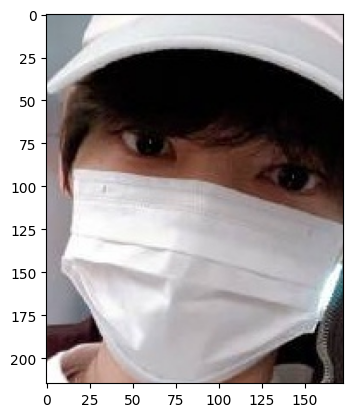

In [ ]:
# displaying with mask image
img = mpimg.imread('/content/data/with_mask/with_mask_123.jpg')
imgplot = plt.imshow(img)
plt.show()

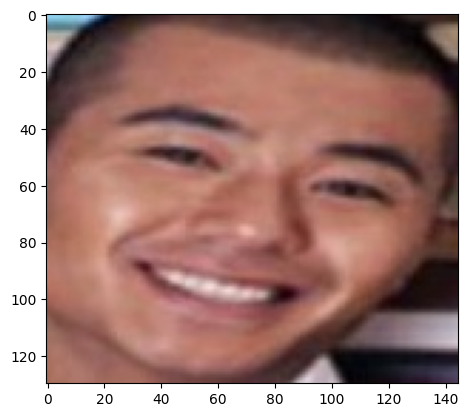

In [ ]:
# displaying without mask image
img = mpimg.imread('/content/data/without_mask/without_mask_123.jpg')
imgplot = plt.imshow(img)
plt.show()

#Image Preprocessing



1.   Resizing the images
2.   Converting the images into numpy arrays



In [ ]:
# convert images to numpy arrays+

with_mask_path = '/content/data/with_mask/'

data = []

for img_file in with_mask_files:

  image = Image.open(with_mask_path + img_file)
  image = image.resize((128,128))
  image = image.convert('RGB')
  image = np.array(image)
  data.append(image)



without_mask_path = '/content/data/without_mask/'


for img_file in without_mask_files:

  image = Image.open(without_mask_path + img_file)
  image = image.resize((128,128))
  image = image.convert('RGB')
  image = np.array(image)
  data.append(image)

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:1054: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


In [ ]:
type(data)

list

In [ ]:
len(data)

7553

array([[[ 62,  66,  65],
        [ 51,  55,  54],
        [ 45,  50,  49],
        ...,
        [ 72,  72,  70],
        [ 71,  71,  68],
        [ 72,  71,  67]],

       [[ 58,  61,  60],
        [ 46,  50,  49],
        [ 42,  46,  45],
        ...,
        [ 81,  81,  79],
        [ 71,  71,  67],
        [ 68,  67,  63]],

       [[ 57,  60,  57],
        [ 55,  58,  55],
        [ 52,  54,  52],
        ...,
        [ 71,  71,  69],
        [ 65,  64,  61],
        [ 63,  62,  58]],

       ...,

       [[ 84,  91,  57],
        [ 72,  78,  44],
        [ 54,  57,  26],
        ...,
        [146, 179, 118],
        [144, 176, 116],
        [144, 175, 116]],

       [[ 84,  95,  60],
        [ 76,  86,  52],
        [ 62,  69,  36],
        ...,
        [143, 178, 117],
        [141, 174, 114],
        [142, 173, 114]],

       [[ 81,  95,  59],
        [ 74,  86,  51],
        [ 64,  72,  39],
        ...,
        [143, 175, 115],
        [140, 171, 112],
        [142, 173, 114]]], dtype=uint8)
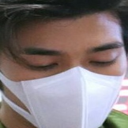

In [ ]:
data[0]

In [ ]:
type(data[0])

numpy.ndarray

In [ ]:
data[0].shape

(128, 128, 3)

In [ ]:
# converting image list and label list to numpy arrays

X = np.array(data)
Y = np.array(labels)

In [ ]:
type(X)

numpy.ndarray

In [ ]:
type(Y)

numpy.ndarray

In [ ]:
print(X.shape)
print(Y.shape)

(7553, 128, 128, 3)
(7553,)


In [ ]:
print(Y)

[1 1 1 ... 0 0 0]


#Creating Train and Test Dataset

In [ ]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=2)

In [ ]:
print(X.shape, X_train.shape, X_test.shape)

(7553, 128, 128, 3) (6042, 128, 128, 3) (1511, 128, 128, 3)


In [ ]:
# scaling the data

X_train_scaled = X_train/255

X_test_scaled = X_test/255

array([[[74, 62, 50],
        [70, 58, 46],
        [59, 49, 39],
        ...,
        [16, 16, 16],
        [16, 16, 16],
        [16, 16, 16]],

       [[73, 61, 49],
        [69, 57, 45],
        [58, 48, 36],
        ...,
        [16, 16, 16],
        [16, 16, 16],
        [16, 16, 16]],

       [[69, 57, 45],
        [65, 53, 41],
        [56, 45, 32],
        ...,
        [16, 16, 16],
        [16, 16, 16],
        [16, 16, 16]],

       ...,

       [[19, 14, 11],
        [19, 14, 11],
        [19, 14, 11],
        ...,
        [22, 14,  6],
        [20, 13,  5],
        [20, 13,  5]],

       [[19, 15, 12],
        [19, 15, 12],
        [18, 13, 10],
        ...,
        [25, 16,  9],
        [22, 14,  6],
        [21, 12,  5]],

       [[19, 15, 12],
        [19, 15, 12],
        [17, 13,  9],
        ...,
        [26, 17, 10],
        [23, 14,  7],
        [21, 12,  5]]], dtype=uint8)
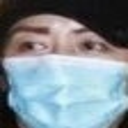

In [ ]:
X_train[0]

In [ ]:
X_train_scaled[0]

array([[[0.29019608, 0.24313725, 0.19607843],
        [0.2745098 , 0.22745098, 0.18039216],
        [0.23137255, 0.19215686, 0.15294118],
        ...,
        [0.0627451 , 0.0627451 , 0.0627451 ],
        [0.0627451 , 0.0627451 , 0.0627451 ],
        [0.0627451 , 0.0627451 , 0.0627451 ]],

       [[0.28627451, 0.23921569, 0.19215686],
        [0.27058824, 0.22352941, 0.17647059],
        [0.22745098, 0.18823529, 0.14117647],
        ...,
        [0.0627451 , 0.0627451 , 0.0627451 ],
        [0.0627451 , 0.0627451 , 0.0627451 ],
        [0.0627451 , 0.0627451 , 0.0627451 ]],

       [[0.27058824, 0.22352941, 0.17647059],
        [0.25490196, 0.20784314, 0.16078431],
        [0.21960784, 0.17647059, 0.1254902 ],
        ...,
        [0.0627451 , 0.0627451 , 0.0627451 ],
        [0.0627451 , 0.0627451 , 0.0627451 ],
        [0.0627451 , 0.0627451 , 0.0627451 ]],

       ...,

       [[0.0745098 , 0.05490196, 0.04313725],
        [0.0745098 , 0.05490196, 0.04313725],
        [0.0745098 , 0

#Building the Convolutional Neural Network (CNN)

In [ ]:
import tensorflow as tf
from tensorflow import keras

In [ ]:
num_of_classes = 2

model = keras.Sequential()

model.add(keras.layers.Conv2D(32, kernel_size=(3,3), activation='relu', input_shape=(128,128,3)))
model.add(keras.layers.MaxPooling2D(pool_size=(2,2)))


model.add(keras.layers.Conv2D(64, kernel_size=(3,3), activation='relu'))
model.add(keras.layers.MaxPooling2D(pool_size=(2,2)))

model.add(keras.layers.Flatten())

model.add(keras.layers.Dense(128, activation='relu'))
model.add(keras.layers.Dropout(0.5))

model.add(keras.layers.Dense(64, activation='relu'))
model.add(keras.layers.Dropout(0.5))


model.add(keras.layers.Dense(num_of_classes, activation='sigmoid'))

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
# compile the neural network
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['acc'])

In [ ]:
# training the neural network
history = model.fit(X_train_scaled, Y_train, validation_split=0.1, epochs=5)

Epoch 1/5
170/170 ━━━━━━━━━━━━━━━━━━━━ 16s 55ms/step - acc: 0.7225 - loss: 0.6099 - val_acc: 0.8760 - val_loss: 0.2880
Epoch 2/5
170/170 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - acc: 0.8813 - loss: 0.2932 - val_acc: 0.8579 - val_loss: 0.3557
Epoch 3/5
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - acc: 0.9048 - loss: 0.2438 - val_acc: 0.8942 - val_loss: 0.2501
Epoch 4/5
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - acc: 0.9242 - loss: 0.1911 - val_acc: 0.9091 - val_loss: 0.2363
Epoch 5/5
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - acc: 0.9348 - loss: 0.1689 - val_acc: 0.9058 - val_loss: 0.2717


#Model Evaluation

In [ ]:
loss, accuracy = model.evaluate(X_test_scaled, Y_test)
print('Test Accuracy =', accuracy)

48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - acc: 0.9151 - loss: 0.2165
Test Accuracy = 0.9245532751083374


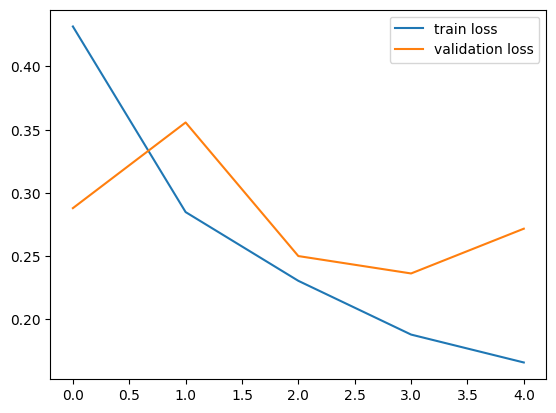

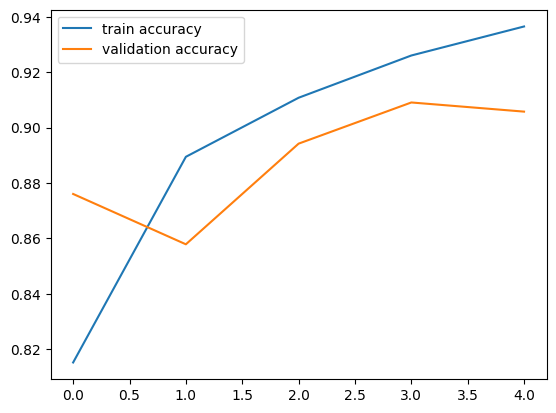

In [ ]:
h = history

# plot the loss value
plt.plot(h.history['loss'], label='train loss')
plt.plot(h.history['val_loss'], label='validation loss')
plt.legend()
plt.show()

# plot the accuracy value
plt.plot(h.history['acc'], label='train accuracy')
plt.plot(h.history['val_acc'], label='validation accuracy')
plt.legend()
plt.show()

In [ ]:
from sklearn.metrics import confusion_matrix, accuracy_score, recall_score, precision_score

In [ ]:
# Predicting the test dataset
y_pred = model.predict(X_test_scaled)
y_pred_classes = np.argmax(y_pred, axis=1)

48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


In [ ]:
# Confusion matrix
conf_matrix = confusion_matrix(Y_test, y_pred_classes)

# Calculate accuracy, sensitivity (recall), and specificity
accuracy = accuracy_score(Y_test, y_pred_classes)
sensitivity = recall_score(Y_test, y_pred_classes, pos_label=1)  # Assuming 1 is the label for "with mask"
specificity = conf_matrix[0, 0] / (conf_matrix[0, 0] + conf_matrix[0, 1])  # TN / (TN + FP)

print(f"Accuracy: {accuracy:.2f}")
print(f"Sensitivity (Recall): {sensitivity:.2f}")
print(f"Specificity: {specificity:.2f}")

Accuracy: 0.92
Sensitivity (Recall): 0.93
Specificity: 0.92


In [ ]:
# Predicting the test dataset
y_pred = model.predict(X_test_scaled)

# Apply threshold-based classification
threshold = 0.7
y_pred_classes = (y_pred[:, 1] > threshold).astype(int)

48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


In [ ]:
# Confusion matrix
conf_matrix = confusion_matrix(Y_test, y_pred_classes)

# Calculate accuracy, sensitivity (recall), and specificity
accuracy = accuracy_score(Y_test, y_pred_classes)
sensitivity = recall_score(Y_test, y_pred_classes, pos_label=1)  # Assuming 1 is the label for "with mask"
specificity = conf_matrix[0, 0] / (conf_matrix[0, 0] + conf_matrix[0, 1])  # TN / (TN + FP)

print(f"Accuracy: {accuracy:.2f}")
print(f"Sensitivity (Recall): {sensitivity:.2f}")
print(f"Specificity: {specificity:.2f}")

Accuracy: 0.90
Sensitivity (Recall): 0.83
Specificity: 0.97


#Predictive System

##Trial Using Argmax

Path of image 1 to be predicted: /content/test_with_mask.jpg
Path of image 2 to be predicted: /content/test_with_mask2.jpg
Path of image 3 to be predicted: /content/test_with_mask3.jpg
Path of image 4 to be predicted: /content/test_with_mask4.jpg
Path of image 5 to be predicted: /content/test_with_mask5.jpg
Path of image 6 to be predicted: /content/test_without_mask.jpg
Path of image 7 to be predicted: /content/test_without_mask2.jpg
Path of image 8 to be predicted: /content/test_without_mask3.jpg
Path of image 9 to be predicted: /content/test_without_mask4.jpg
Path of image 10 to be predicted: /content/test_without_mask5.jpg


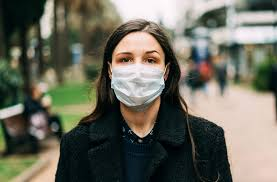

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Prediction for image 1:
Raw probabilities: [[0.44327205 0.71665144]]
The person in the image is wearing a mask.
--------------------------------------------------


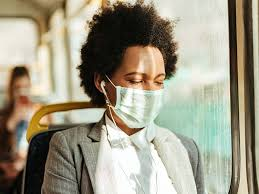

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Prediction for image 2:
Raw probabilities: [[0.45162845 0.7108936 ]]
The person in the image is wearing a mask.
--------------------------------------------------


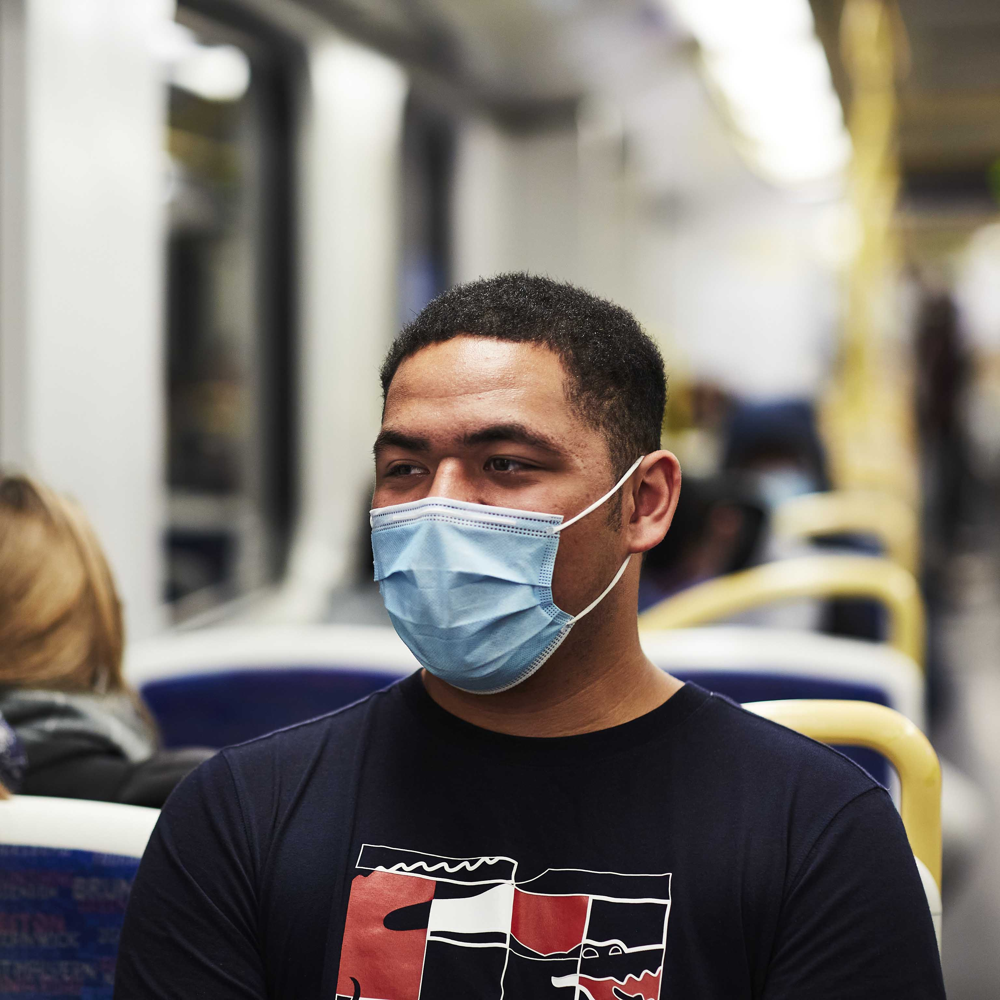

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Prediction for image 3:
Raw probabilities: [[0.08644629 0.9411145 ]]
The person in the image is wearing a mask.
--------------------------------------------------


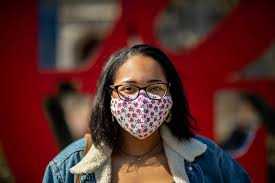

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Prediction for image 4:
Raw probabilities: [[0.3829069 0.7160918]]
The person in the image is wearing a mask.
--------------------------------------------------


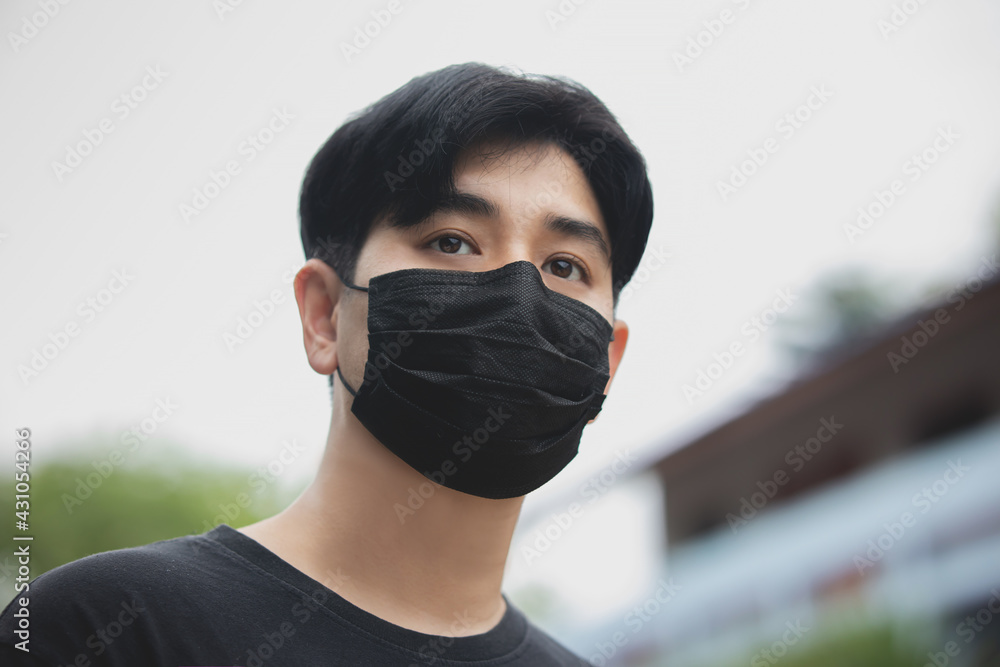

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Prediction for image 5:
Raw probabilities: [[0.3544228  0.70966446]]
The person in the image is wearing a mask.
--------------------------------------------------


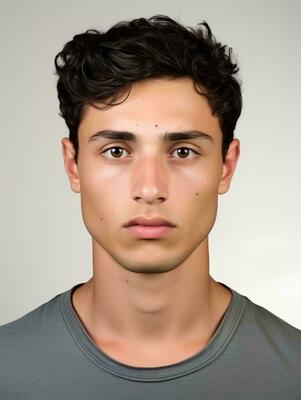

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Prediction for image 6:
Raw probabilities: [[0.41600707 0.64049274]]
The person in the image is wearing a mask.
--------------------------------------------------


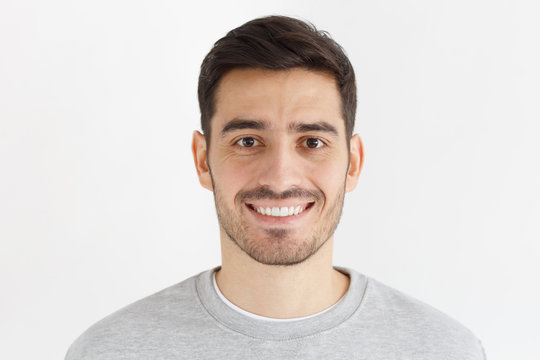

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Prediction for image 7:
Raw probabilities: [[0.40629196 0.6328267 ]]
The person in the image is wearing a mask.
--------------------------------------------------


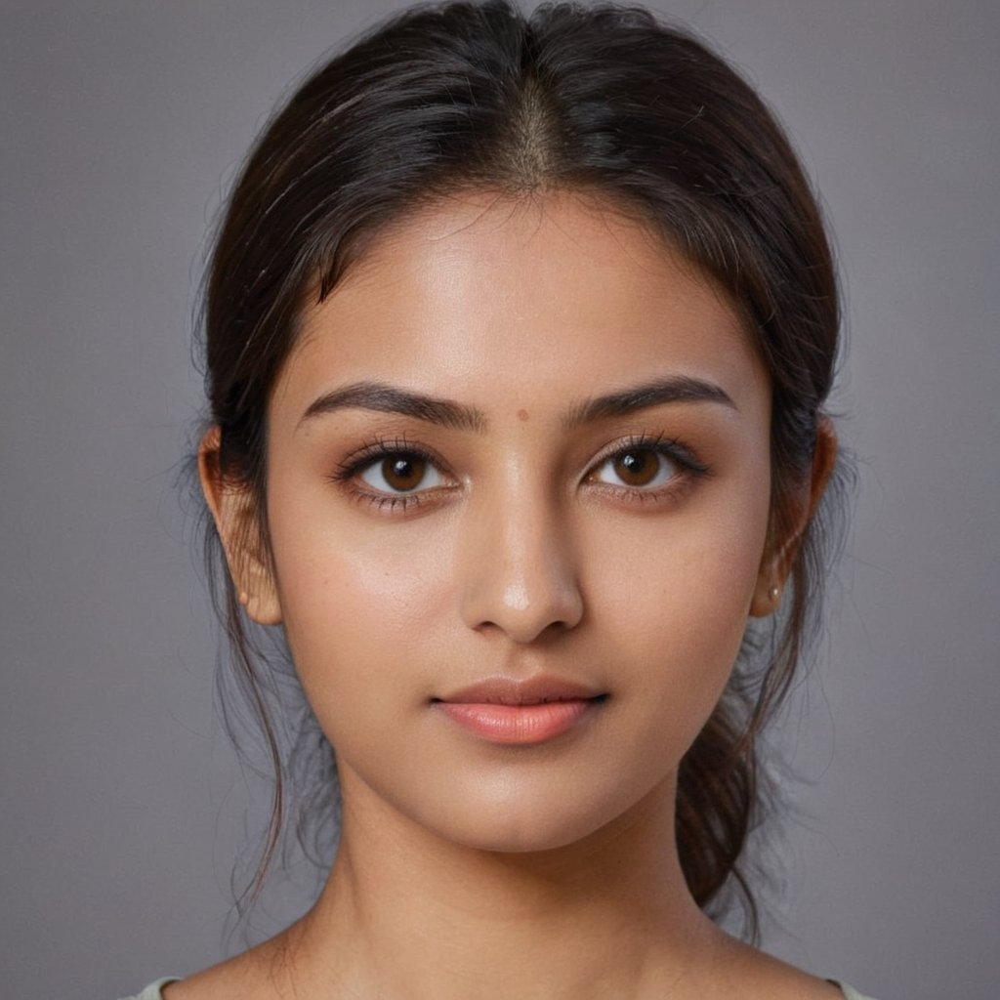

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Prediction for image 8:
Raw probabilities: [[0.32613456 0.73736405]]
The person in the image is wearing a mask.
--------------------------------------------------


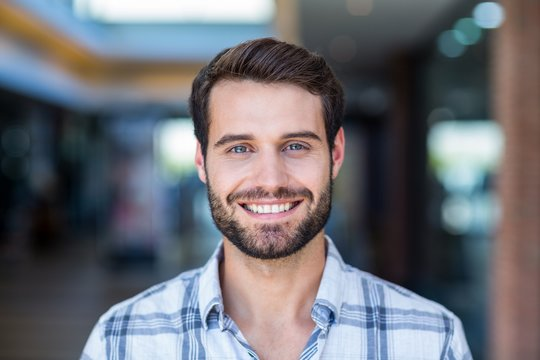

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
Prediction for image 9:
Raw probabilities: [[0.4175031  0.61594325]]
The person in the image is wearing a mask.
--------------------------------------------------


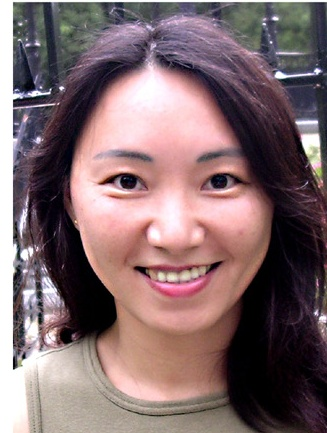

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
Prediction for image 10:
Raw probabilities: [[0.3275625 0.8015218]]
The person in the image is wearing a mask.
--------------------------------------------------


In [ ]:
#FINAL
# List of 10 image paths
image_paths = []
for i in range(10):
    path = input(f'Path of image {i+1} to be predicted: ')
    image_paths.append(path)

# Loop through each image path
for idx, image_path in enumerate(image_paths):
    # Read and display the input image
    input_image = cv2.imread(image_path)
    cv2_imshow(input_image)

    # Resize, scale, and reshape the image
    input_image_resized = cv2.resize(input_image, (128, 128))
    input_image_scaled = input_image_resized / 255
    input_image_reshaped = np.reshape(input_image_scaled, [1, 128, 128, 3])

    # Predict the result
    input_prediction = model.predict(input_image_reshaped)
    input_pred_label = np.argmax(input_prediction)

    # Display the prediction
    print(f"Prediction for image {idx + 1}:")
    print(f"Raw probabilities: {input_prediction}")
    if input_pred_label == 1:
        print('The person in the image is wearing a mask.')
    else:
        print('The person in the image is not wearing a mask.')
    print('-' * 50)

Using the argmax function results in incorrect classification of the images of 'not wearing a mask'. During evaluation, it was noted that while the model exhibited high specificity (92%), it consistently misclassified instances of people not wearing masks as wearing masks. This suggests that the default decision rule (argmax), which simply selects the class with the highest predicted probability, was insufficient in distinguishing between the two classes with the desired granularity.

##Trial Using Threshold of 0.7

The threshold value of 0.7 was chosen empirically through testing on various images and observing model performance. Adjusting this value allowed for the identification of a sweet spot where the model correctly classified both "wearing a mask" and "not wearing a mask" with improved accuracy.

Path of image 1 to be predicted: /content/test_with_mask.jpg
Path of image 2 to be predicted: /content/test_with_mask2.jpg
Path of image 3 to be predicted: /content/test_with_mask3.jpg
Path of image 4 to be predicted: /content/test_with_mask4.jpg
Path of image 5 to be predicted: /content/test_with_mask5.jpg
Path of image 6 to be predicted: /content/test_without_mask2.jpg
Path of image 7 to be predicted: /content/test_without_mask.jpg
Path of image 8 to be predicted: /content/test_without_mask3.jpg
Path of image 9 to be predicted: /content/test_without_mask4.jpg
Path of image 10 to be predicted: /content/test_without_mask5.jpg


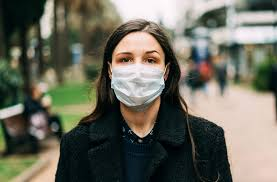

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Prediction for image 1:
Raw probabilities: [[0.44327205 0.71665144]]
The person in the image is wearing a mask.
--------------------------------------------------


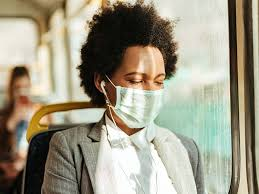

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Prediction for image 2:
Raw probabilities: [[0.45162845 0.7108936 ]]
The person in the image is wearing a mask.
--------------------------------------------------


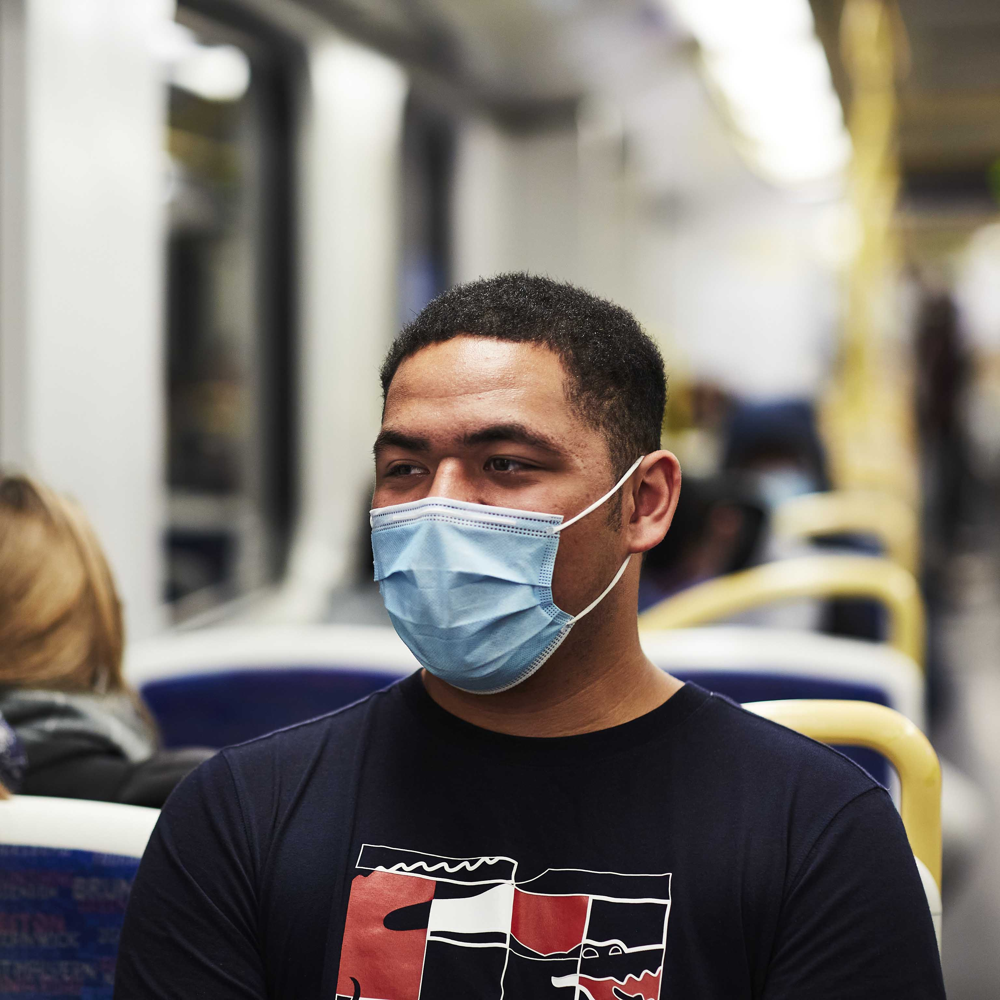

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Prediction for image 3:
Raw probabilities: [[0.08644629 0.9411145 ]]
The person in the image is wearing a mask.
--------------------------------------------------


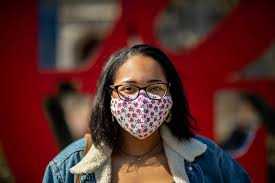

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Prediction for image 4:
Raw probabilities: [[0.3829069 0.7160918]]
The person in the image is wearing a mask.
--------------------------------------------------


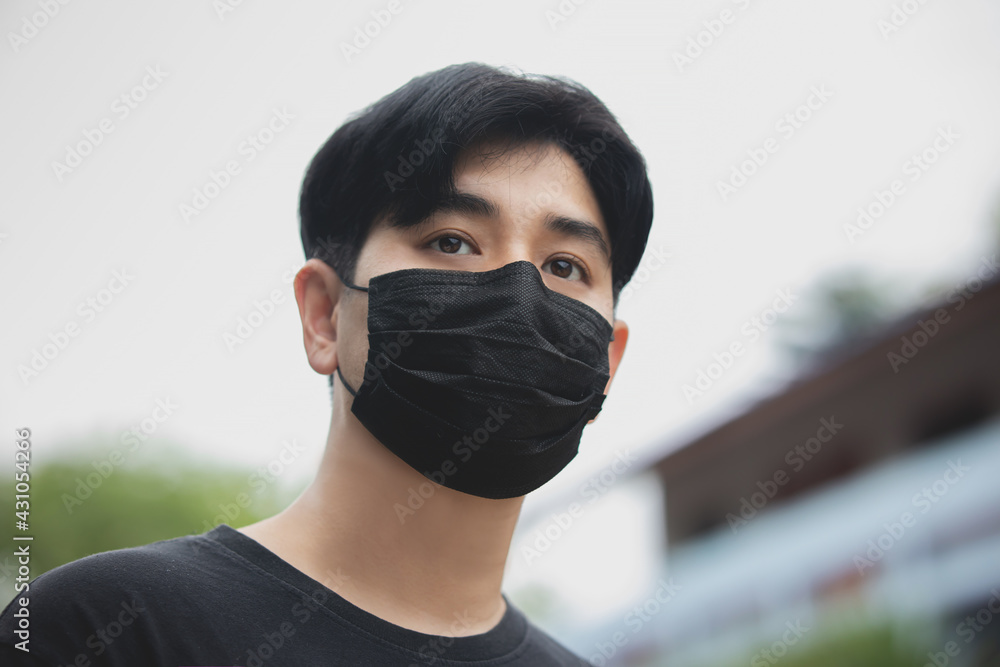

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Prediction for image 5:
Raw probabilities: [[0.3544228  0.70966446]]
The person in the image is wearing a mask.
--------------------------------------------------


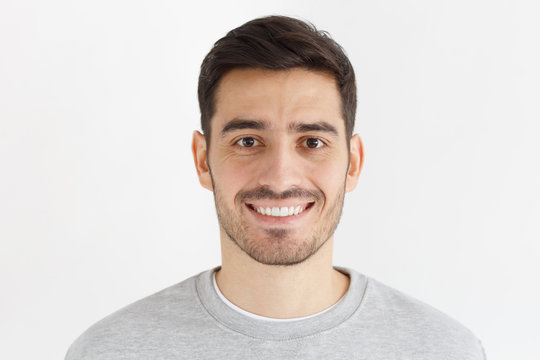

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Prediction for image 6:
Raw probabilities: [[0.40629196 0.6328267 ]]
The person in the image is not wearing a mask.
--------------------------------------------------


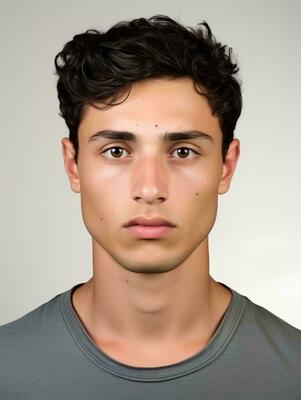

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Prediction for image 7:
Raw probabilities: [[0.41600707 0.64049274]]
The person in the image is not wearing a mask.
--------------------------------------------------


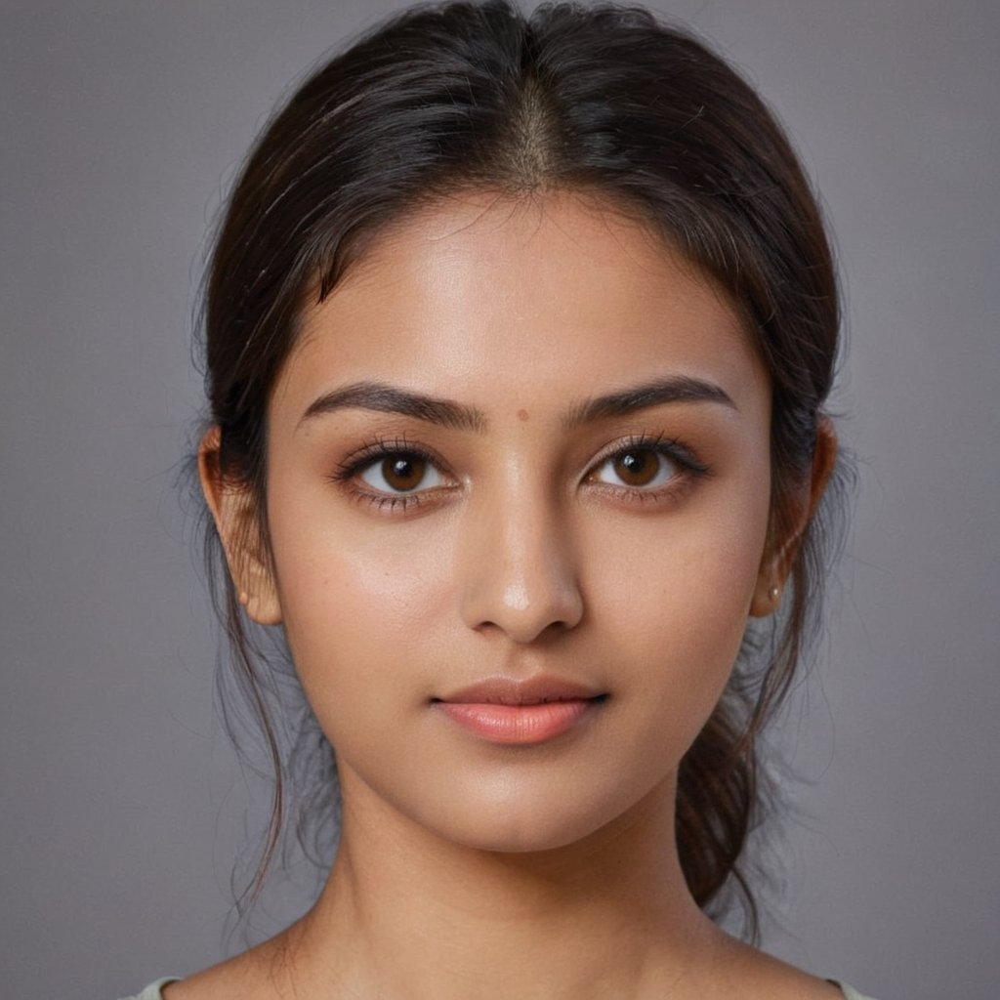

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Prediction for image 8:
Raw probabilities: [[0.32613456 0.73736405]]
The person in the image is wearing a mask.
--------------------------------------------------


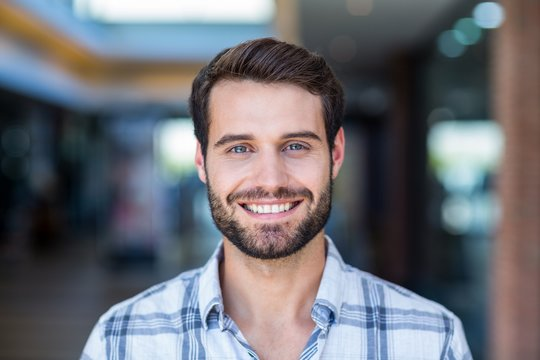

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Prediction for image 9:
Raw probabilities: [[0.4175031  0.61594325]]
The person in the image is not wearing a mask.
--------------------------------------------------


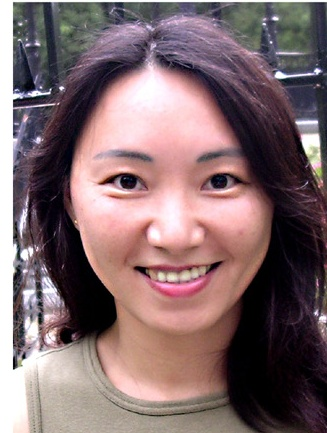

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Prediction for image 10:
Raw probabilities: [[0.3275625 0.8015218]]
The person in the image is wearing a mask.
--------------------------------------------------


In [ ]:
#FINAL
# List of 10 image paths
image_paths = []
for i in range(10):
    path = input(f'Path of image {i+1} to be predicted: ')
    image_paths.append(path)

# Loop through each image path
for idx, image_path in enumerate(image_paths):
    # Read and display the input image
    input_image = cv2.imread(image_path)
    cv2_imshow(input_image)

    # Resize, scale, and reshape the image
    input_image_resized = cv2.resize(input_image, (128, 128))
    input_image_scaled = input_image_resized / 255
    input_image_reshaped = np.reshape(input_image_scaled, [1, 128, 128, 3])

    # Predict the result
    input_prediction = model.predict(input_image_reshaped)
    threshold = 0.7
    input_pred_label = 1 if input_prediction[0][1] > threshold else 0

    # Display the prediction
    print(f"Prediction for image {idx + 1}:")
    print(f"Raw probabilities: {input_prediction}")
    if input_pred_label == 1:
        print('The person in the image is wearing a mask.')
    else:
        print('The person in the image is not wearing a mask.')
    print('-' * 50)